In [29]:
import argparse
import os
import sys
import numpy as np

import torch
import matplotlib.pyplot as plt     # type: ignore

things_stim_path = '/user_data/mmhender/stimuli/things/'
save_stim_path = '/user_data/mmhender/stimuli/featsynth/images_superord_prototypes'
# save_stim_path = '/user_data/mmhender/stimuli/featsynth/images_superord_prototypes/DEBUG/'

save_stim_path_v1 = '/user_data/mmhender/stimuli/featsynth/images_v1'

texture_synth_root = os.path.dirname(os.getcwd())

texture_synth_root

sys.path.append(os.path.join(texture_synth_root, 'code'))

import utilities
import model_combineimages
import optimize_combineimages

import pandas as pd
import PIL
import time
import things_utils

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(device)

In [30]:
# this is the set of 200 concepts used in behav experiments
fn = '/user_data/mmhender/featsynth/code/make_expt_designs/expt1_categ_info.npy'
info = np.load(fn, allow_pickle=True).item()
categ_names = info['super_names']
n_categ = len(categ_names)
concept_names_subsample = [info['basic_names'][info['super_inds_long']==si] \
                          for si in range(n_categ)]


/tmp/ipykernel_10578/2808696069.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12,3))


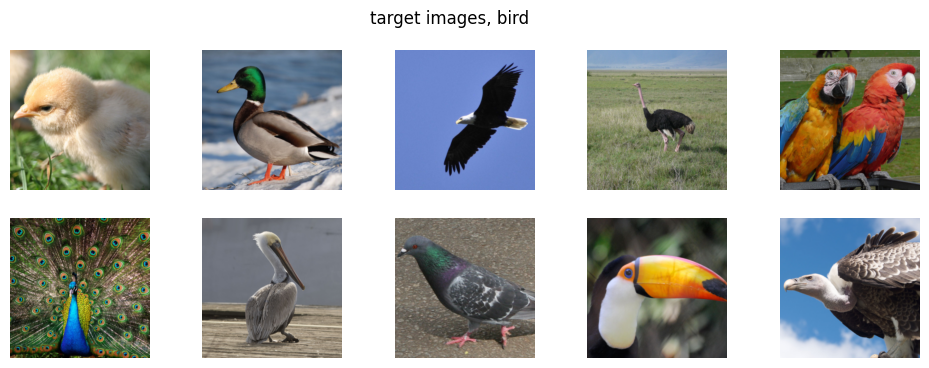

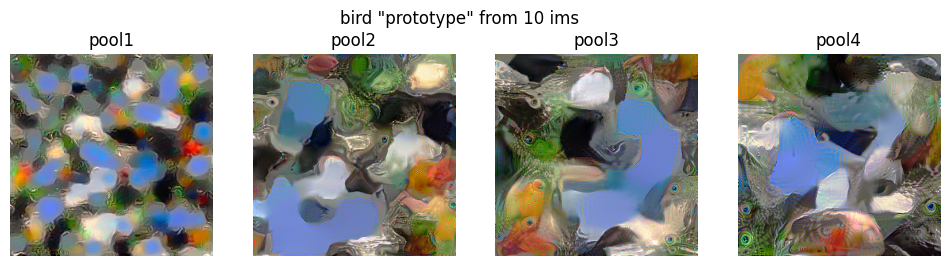

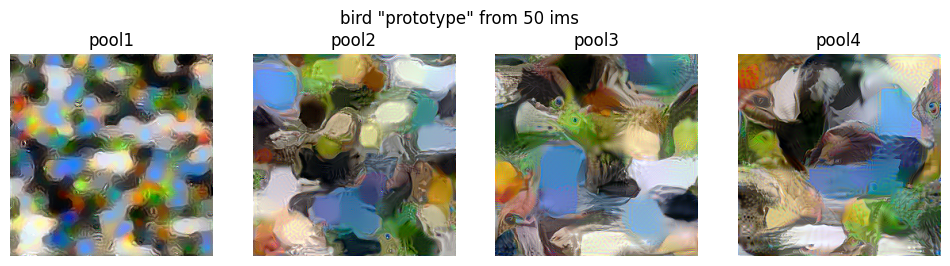

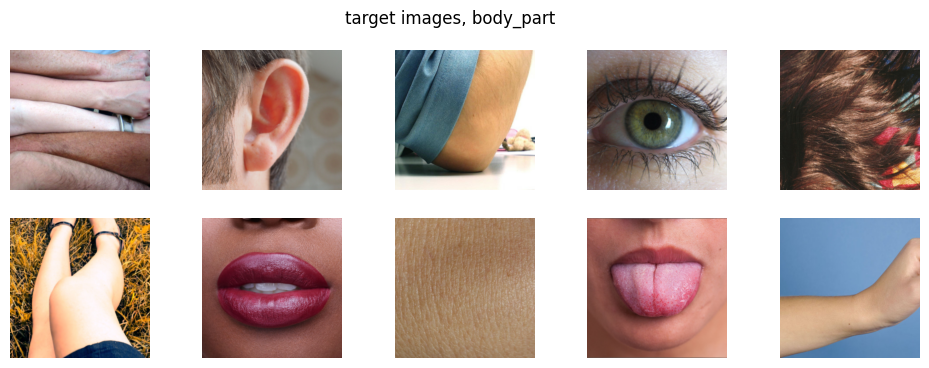

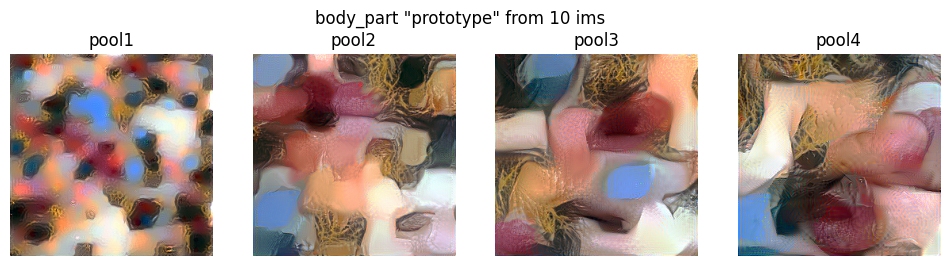

...

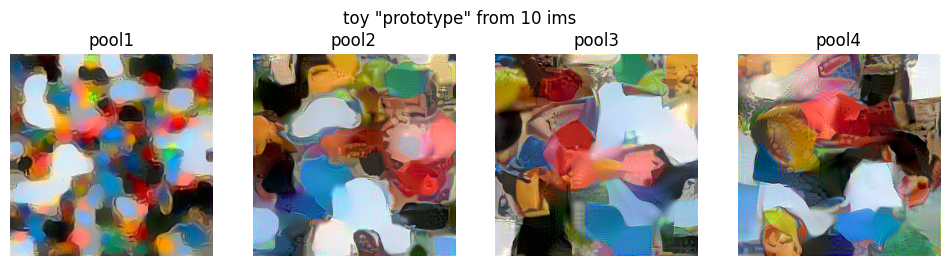

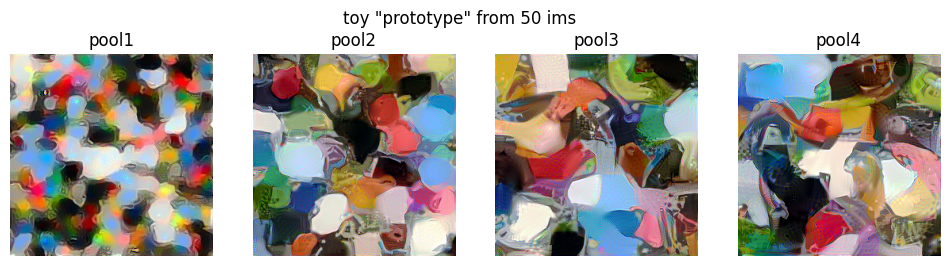

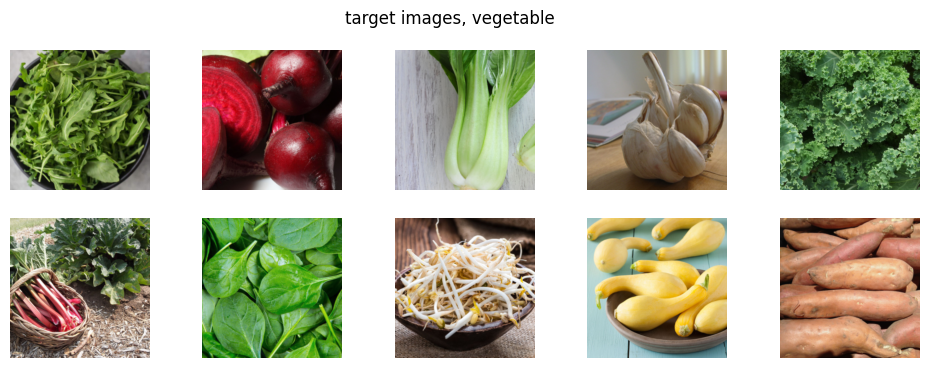

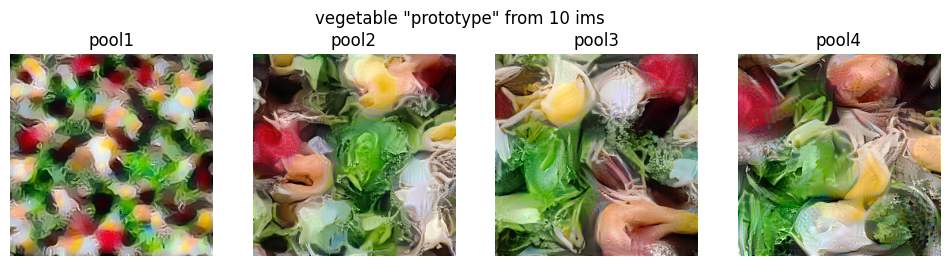

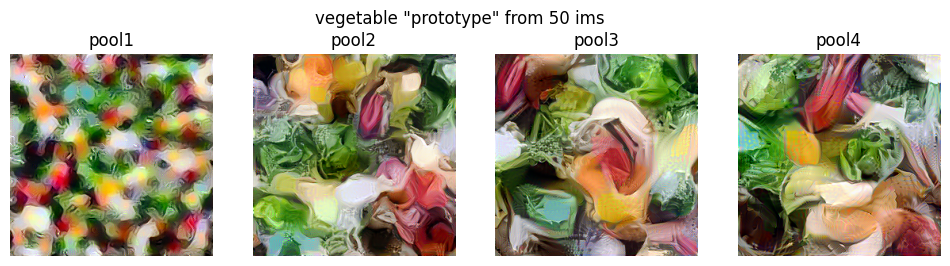

In [35]:
for ca in np.arange(n_categ):
    
        
    categ = categ_names[ca]
    
    n_ims_combine = 10;
    
    exemplars_combine = np.arange(1)
    
    
    target_image_filenames = np.concatenate(\
                                    [[things_utils.get_filename(categ, conc, ii) \
                                      for ii in exemplars_combine] \
                                      for conc in concept_names_subsample[ca]], \
                                        axis=0)
    
    plt.figure(figsize=(12,4))
    
    n_ims_plot = 10;
    for ii in range(n_ims_plot):
    
        fn = target_image_filenames[ii]
    
        im_orig = utilities.preprocess_image_tosave(utilities.load_image(fn))
    
        plt.subplot(2,5, ii+1)
    
        plt.imshow(im_orig)
        plt.axis('off')
    
    plt.suptitle('target images, %s'%(categ));
    
    for n_ims_combine in [10,50]:
            
        plt.figure(figsize=(12,3))
        
        out_dir = os.path.join(save_stim_path, '%s_prototype_%dims'%(categ, n_ims_combine))
        layers_plot = ['pool1','pool2','pool3','pool4']
        
        for ll in range(4):
        
            plt.subplot(1,4,ll+1)
            fn = os.path.join(out_dir, 'grid%d_%dx%d_upto_%s.png'%(5, 1, 1, layers_plot[ll]))
            im = PIL.Image.open(fn)
            plt.imshow(im)
            plt.axis('off')
            plt.title('%s'%(layers_plot[ll]))
        
        plt.suptitle('%s "prototype" from %d ims'%(categ, n_ims_combine));

In [38]:
im.size

(256, 256)